# Food Prices

In [2]:
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns

## World

In [ ]:
df_world = pd.read_csv('wfpvam_foodprices.csv')
df_world

,adm0_id,adm0_name,adm1_id,adm1_name,mkt_id,mkt_name,cm_id,cm_name,cur_id,cur_name,pt_id,pt_name,um_id,um_name,mp_month,mp_year,mp_price,mp_commoditysource
0,1.0,Afghanistan,272.0,Badakhshan,266.0,Fayzabad,55.0,Bread - Retail,0.0,AFN,15.0,Retail,5.0,KG,1.0,2014.0,50.00,NaN
1,1.0,Afghanistan,272.0,Badakhshan,266.0,Fayzabad,55.0,Bread - Retail,0.0,AFN,15.0,Retail,5.0,KG,2.0,2014.0,50.00,NaN
2,1.0,Afghanistan,272.0,Badakhshan,266.0,Fayzabad,55.0,Bread - Retail,0.0,AFN,15.0,Retail,5.0,KG,3.0,2014.0,50.00,NaN
3,1.0,Afghanistan,272.0,Badakhshan,266.0,Fayzabad,55.0,Bread - Retail,0.0,AFN,15.0,Retail,5.0,KG,4.0,2014.0,50.00,NaN
4,1.0,Afghanistan,272.0,Badakhshan,266.0,Fayzabad,55.0,Bread - Retail,0.0,AFN,15.0,Retail,5.0,KG,5.0,2014.0,50.00,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
51437,115.0,Bassas da India,1485.0,NaN,941.0,Hyderabad,83.0,Potatoes - Retail,0.0,INR,15.0,Retail,5.0,KG,7.0,2021.0,20.67,NaN
51438,115.0,Bassas da India,1485.0,NaN,941.0,Hyderabad,84.0,Wheat - Retail,0.0,INR,15.0,Retail,5.0,KG,1.0,1994.0,7.50,NaN
51439,115.0,Bassas da India,1485.0,NaN,941.0,Hyderabad,84.0,Wheat - Retail,0.0,INR,15.0,Retail,5.0,KG,2.0,1994.0,7.20,NaN
51440,115.0,Bassas da India,1485.0,NaN,941.0,Hyderabad,84.0,Wheat - Retail,0.0,INR,15.0,Retail,5.0,KG,3.0,1994.0,7.00,NaN


In [ ]:
df_world['cm_name'].unique()

['Bread - Retail' 'Wheat - Retail' 'Rice (low quality) - Retail'
 'Wage (qualified labour) - Retail'
 'Livestock (sheep, one-year-old alive female) - Retail'
 'Fuel (diesel) - Retail' 'Exchange rate - Retail'
 'Wage (non-qualified labour, non-agricultural) - Retail'
 'Oil (cooking) - Retail' 'Sugar - Retail' 'Pulses - Retail'
 'Wheat flour (high quality) - Retail' 'Salt - Retail'
 'Rice (high quality) - Retail' 'Wheat flour (low quality) - Retail'
 'Wheat flour - Retail' 'Rice - Retail' 'Beans (white) - Retail'
 'Milk - Retail' 'Potatoes - Retail' 'Eggs - Retail'
 'Meat (chicken) - Retail' 'Lentils - Retail' 'Pasta - Retail'
 'Tomatoes - Retail' 'Oil - Retail' 'Meat (beef) - Retail'
 'Cheese (dry) - Retail' 'Carrots - Retail' 'Onions - Retail'
 'Bananas - Retail' 'Tea - Retail' 'Fuel (petrol-gasoline) - Retail'
 'Fish (canned) - Retail' 'Apples - Retail' 'Oranges - Retail'
 'Milk (camel) - Retail' 'Meat (camel) - Retail' 'Tea (sahm) - Retail'
 'Oil (palm) - Retail' 'Cassava flour - Ret

## PH

### Load Data

In [ ]:
df_ph = pd.read_csv('wfp_food_prices_phl.csv')
df_ph

<ipython-input-44-18f6cdcc5e21>:1: DtypeWarning: Columns (4,5,12,13) have mixed types. Specify dtype option on import or set low_memory=False.
  df_ph = pd.read_csv('wfp_food_prices_phl.csv')


,date,admin1,admin2,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,currency,price,usdprice
0,#date,#adm1+name,#adm2+name,#loc+market+name,#geo+lat,#geo+lon,#item+type,#item+name,#item+unit,#item+price+flag,#item+price+type,#currency,#value,#value+usd
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,PHP,15.0,0.3717
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,PHP,20.0,0.4957
3,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Wholesale,PHP,18.35,0.4548
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,PHP,18.0,0.4461
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144823,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Bitter melon,KG,forecast,Retail,PHP,0.0,0.0
144824,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Cabbage (chinese),KG,forecast,Retail,PHP,0.0,0.0
144825,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Coconut,KG,forecast,Retail,PHP,0.0,0.0
144826,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Eggplants,KG,forecast,Retail,PHP,0.0,0.0


### Clean Data

In [ ]:
df_ph = df_ph.drop(0)
df_ph

,date,admin1,admin2,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,currency,price,usdprice
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,PHP,15.0,0.3717
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,PHP,20.0,0.4957
3,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Wholesale,PHP,18.35,0.4548
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,PHP,18.0,0.4461
5,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Wholesale,PHP,16.35,0.4052
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
144823,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Bitter melon,KG,forecast,Retail,PHP,0.0,0.0
144824,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Cabbage (chinese),KG,forecast,Retail,PHP,0.0,0.0
144825,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Coconut,KG,forecast,Retail,PHP,0.0,0.0
144826,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Eggplants,KG,forecast,Retail,PHP,0.0,0.0


In [ ]:
df_ph['currency'].unique()

array(['PHP'], dtype=object)

In [ ]:
df_ph.drop(columns=['currency', 'usdprice'], inplace=True)
df_ph

,date,admin1,admin2,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.0
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.0
3,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Wholesale,18.35
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.0
5,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Wholesale,16.35
...,...,...,...,...,...,...,...,...,...,...,...,...
144823,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Bitter melon,KG,forecast,Retail,0.0
144824,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Cabbage (chinese),KG,forecast,Retail,0.0
144825,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Coconut,KG,forecast,Retail,0.0
144826,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Eggplants,KG,forecast,Retail,0.0


In [ ]:
df_ph.shape

(144827, 12)

In [ ]:
df_ph.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144827 entries, 1 to 144827
Data columns (total 12 columns):
 #   Column     Non-Null Count   Dtype         
---  ------     --------------   -----         
 0   date       144827 non-null  datetime64[ns]
 1   admin1     144827 non-null  object        
 2   admin2     144827 non-null  object        
 3   market     144827 non-null  object        
 4   latitude   144827 non-null  object        
 5   longitude  144827 non-null  object        
 6   category   144827 non-null  object        
 7   commodity  144827 non-null  object        
 8   unit       144827 non-null  object        
 9   priceflag  144827 non-null  object        
 10  pricetype  144827 non-null  object        
 11  price      144827 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(10)
memory usage: 13.3+ MB


In [ ]:
df_ph['date'] = pd.to_datetime(df_ph['date'])

In [ ]:
start_date = df_ph['date'].min()
end_date = df_ph['date'].max()

print(f"Start Date: {start_date}")
print(f"End Date: {end_date}")

Start Date: 2000-01-15 00:00:00
End Date: 2024-01-15 00:00:00


In [ ]:
df_ph['price'] = pd.to_numeric(df_ph['price'], errors='coerce')

In [ ]:
df_ph.dtypes

date         datetime64[ns]
admin1               object
admin2               object
market               object
category             object
commodity            object
unit                 object
priceflag            object
pricetype            object
price               float64
dtype: object

In [ ]:
df_ph.isna().sum()

date         0
admin1       0
admin2       0
market       0
latitude     0
longitude    0
category     0
commodity    0
unit         0
priceflag    0
pricetype    0
price        0
dtype: int64

In [ ]:
df_ph.drop_duplicates(inplace=True)

In [ ]:
df_ph

,date,admin1,admin2,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.00
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.00
3,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Wholesale,18.35
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
5,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Wholesale,16.35
...,...,...,...,...,...,...,...,...,...,...,...,...
144823,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Bitter melon,KG,forecast,Retail,0.00
144824,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Cabbage (chinese),KG,forecast,Retail,0.00
144825,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Coconut,KG,forecast,Retail,0.00
144826,2024-01-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Eggplants,KG,forecast,Retail,0.00


### EDA

In [ ]:
df_ph['admin1'].unique()

['National Capital region' 'Region III' 'Region IX' 'Region VI'
 'Region VII' 'Region XI' 'Region XII'
 'Autonomous region in Muslim Mindanao' 'Cordillera Administrative region'
 'Region I' 'Region II' 'Region IV-A' 'Region IV-B' 'Region V'
 'Region VIII' 'Region X' 'Region XIII']


In [ ]:
df_ph['admin2'].unique()

['Metropolitan Manila' 'Nueva Ecija' 'Zamboanga del Sur' 'Iloilo' 'Cebu'
 'Davao del Sur' 'South Cotabato' 'Maguindanao' 'Benguet' 'Pangasinan'
 'Cagayan' 'Rizal' 'Palawan' 'Albay' 'Southern Leyte' 'Lanao del Norte'
 'Surigao del Sur' 'Basilan' 'Sulu' 'Tawi-Tawi' 'Abra' 'Apayao' 'Ifugao'
 'Kalinga' 'Mountain Province' 'Ilocos Norte' 'Ilocos Sur' 'La Union'
 'Isabela' 'Nueva Vizcaya' 'Quirino' 'Aurora' 'Bataan' 'Bulacan' 'Tarlac'
 'Zambales' 'Batangas' 'Cavite' 'Laguna' 'Quezon' 'Marinduque'
 'Occidental Mindoro' 'Oriental Mindoro' 'Romblon' 'Zamboanga Sibugay'
 'Zamboanga del Norte' 'Camarines Norte' 'Catanduanes' 'Masbate'
 'Sorsogon' 'Aklan' 'Antique' 'Capiz' 'Guimaras' 'Negros Occidental'
 'Bohol' 'Negros Oriental' 'Siquijor' 'Biliran' 'Eastern Samar' 'Leyte'
 'Northern Samar' 'Samar' 'Bukidnon' 'Camiguin' 'Misamis Occidental'
 'Misamis Oriental' 'Compostela Valley' 'Davao Oriental' 'Davao del Norte'
 'North Cotabato' 'Sarangani' 'Sultan Kudarat' 'Agusan del Norte'
 'Agusan del Sur'

In [ ]:
df_ph['market'].unique()

['Metro Manila' 'Palayan' 'Zamboanga City' 'Iloilo City' 'Cebu City'
 'Davao City' 'Koronadal' 'Shariff Aguak' 'La Trinidad' 'Lingayen'
 'Tuguegarao City' 'Santa Cruz' 'Puerto Princesa' 'Legazpi City'
 'Catarman' 'Tubod' 'Tandag' 'Basilan' 'Maguindanao' 'Sulu' 'Tawi-Tawi'
 'Abra' 'Apayao' 'Benguet' 'Ifugao' 'Kalinga' 'Mountain Province'
 'Ilocos Norte' 'Ilocos Sur' 'La Union (Ilocos Region)' 'Pangasinan'
 'Cagayan' 'Isabela' 'Nueva Vizcaya' 'Quirino' 'Aurora' 'Bataan' 'Bulacan'
 'Pampanga' 'Nueva Ecija' 'Tarlac' 'Zambales' 'Batangas' 'Cavite' 'Laguna'
 'Quezon' 'Rizal' 'Marinduque' 'Occidental Mindoro' 'Oriental Mindoro'
 'Palawan' 'Romblon' 'Zamboanga Sibugay' 'Zamboanga del Norte'
 'Zamboanga del Sur' 'Albay' 'Camarines Norte' 'Catanduanes'
 'Camarines Sur' 'Masbate' 'Sorsogon' 'Aklan' 'Antique' 'Capiz' 'Guimaras'
 'Iloilo' 'Negros Occidental' 'Bohol' 'Cebu' 'Negros Oriental' 'Siquijor'
 'Biliran' 'Eastern Samar' 'Leyte' 'Northern Samar' 'Samar'
 'Southern Leyte' 'Bukidnon' 'Camiguin

In [ ]:
market_admin_mapping = df_ph[['admin1', 'market']].drop_duplicates()
admin1_market_mapping = market_admin_mapping.groupby('admin1')['market'].unique().reset_index()
pd.set_option('display.max_colwidth', None)
admin1_market_mapping

,admin1,market
0,Autonomous region in Muslim Mindanao,"[Shariff Aguak, Basilan, Maguindanao, Sulu, Tawi-Tawi, Lanao del Sur, Cotabato City]"
1,Cordillera Administrative region,"[La Trinidad, Abra, Apayao, Benguet, Ifugao, Kalinga, Mountain Province, Baguio City]"
2,National Capital region,[Metro Manila]
3,Region I,"[Lingayen, Ilocos Norte, Ilocos Sur, La Union (Ilocos Region), Pangasinan, San Fernando City]"
4,Region II,"[Tuguegarao City, Cagayan, Isabela, Nueva Vizcaya, Quirino]"
5,Region III,"[Palayan, Aurora, Bataan, Bulacan, Pampanga, Nueva Ecija, Tarlac, Zambales, Cabanatuan City]"
6,Region IV-A,"[Santa Cruz, Batangas, Cavite, Laguna, Quezon, Rizal, Batangas City]"
7,Region IV-B,"[Puerto Princesa, Marinduque, Occidental Mindoro, Oriental Mindoro, Palawan, Romblon, Calapan City]"
8,Region IX,"[Zamboanga City, Zamboanga Sibugay, Zamboanga del Norte, Zamboanga del Sur]"
9,Region V,"[Legazpi City, Albay, Camarines Norte, Catanduanes, Camarines Sur, Masbate, Sorsogon, Naga City]"


**rename admin1 as Region**

In [ ]:
df_ph.rename(columns={'admin1': 'region', 'admin2': 'province'}, inplace=True)

In [ ]:
df_ph['category'].unique()

['cereals and tubers' 'meat, fish and eggs' 'vegetables and fruits'
 'pulses and nuts' 'oil and fats' 'miscellaneous food']


In [ ]:
df_ph['commodity'].unique()

['Maize flour (yellow)' 'Rice (milled, superior)' 'Rice (regular, milled)'
 'Meat (pork)' 'Maize flour (white)' 'Maize (yellow)' 'Maize (white)'
 'Rice (paddy)' 'Carrots' 'Garlic' 'Potatoes (Irish)' 'Sweet potatoes'
 'Eggs' 'Fish (fresh)' 'Onions (red)' 'Onions (white)' 'Cabbage'
 'Tomatoes' 'Meat (chicken, whole)' 'Meat (beef, chops with bones)'
 'Beans (mung)' 'Groundnuts (unshelled)' 'Rice (premium)' 'Rice (special)'
 'Rice (well milled)' 'Taro' 'Anchovies' 'Crab' 'Fish (frigate tuna)'
 'Fish (mackerel, fresh)' 'Fish (roundscad)' 'Fish (slipmouth)'
 'Fish (threadfin bream)' 'Meat (beef)' 'Meat (pork, with bones)'
 'Shrimp (endeavor)' 'Groundnuts (shelled)' 'Bananas (latundan)'
 'Bananas (saba)' 'Beans (green, fresh)' 'Beans (string)' 'Bitter melon'
 'Bottle gourd' 'Cabbage (chinese)' 'Calamansi' 'Choko' 'Coconut'
 'Eggplants' 'Ginger' 'Papaya' 'Squashes' 'Sweet Potato leaves'
 'Water spinach' 'Semolina (white)' 'Semolina (yellow)' 'Eggs (duck)'
 'Fish (milkfish)' 'Fish (redbelly yel

In [ ]:
df_ph['unit'].unique()

['KG' 'Unit']


In [ ]:
df_ph['priceflag'].unique()

['actual' 'actual,aggregate' 'aggregate' 'forecast']


**remove forecast**

In [ ]:
df_ph = df_ph[~df_ph['priceflag'].str.contains('forecast')]

In [ ]:
df_ph['pricetype'].unique()

['Retail' 'Wholesale' 'Farm Gate']


**Retail only**

In [ ]:
df_ph = df_ph[df_ph['pricetype'] == 'Retail']

In [ ]:
df_ph

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.00
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.00
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
6,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,"meat, fish and eggs",Meat (pork),KG,actual,Retail,105.37
7,2000-01-15,Region III,Nueva Ecija,Palayan,15.5415,121.0848,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,19.00
...,...,...,...,...,...,...,...,...,...,...,...,...
112616,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Eggplants,KG,aggregate,Retail,103.33
112617,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Ginger,KG,aggregate,Retail,114.00
112618,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Mangoes (carabao),KG,aggregate,Retail,106.67
112619,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Papaya,KG,aggregate,Retail,45.00


**remove duplicate rows with same date, market; retain actual**

In [ ]:
duplicate_rows = df_ph[df_ph.duplicated(subset=['date', 'market', 'commodity'], keep=False)]
duplicate_rows

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price


In [ ]:
aggregate_rows = df_ph[df_ph['priceflag'] == 'aggregate']
aggregate_rows

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
108943,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Cotabato City,7.18989,124.243084,cereals and tubers,Potatoes (Irish),KG,aggregate,Retail,82.50
108944,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Cotabato City,7.18989,124.243084,cereals and tubers,Rice (premium),KG,aggregate,Retail,43.50
108945,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Cotabato City,7.18989,124.243084,cereals and tubers,Rice (special),KG,aggregate,Retail,47.50
108946,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Cotabato City,7.18989,124.243084,cereals and tubers,Rice (well milled),KG,aggregate,Retail,40.50
108947,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Cotabato City,7.18989,124.243084,"meat, fish and eggs","Fish (mackerel, fresh)",KG,aggregate,Retail,272.50
...,...,...,...,...,...,...,...,...,...,...,...,...
112616,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Eggplants,KG,aggregate,Retail,103.33
112617,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Ginger,KG,aggregate,Retail,114.00
112618,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Mangoes (carabao),KG,aggregate,Retail,106.67
112619,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Papaya,KG,aggregate,Retail,45.00


In [ ]:
actual_aggregate_rows = df_ph[df_ph['priceflag'] == 'actual,aggregate']
actual_aggregate_rows

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
108403,2020-05-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Rice (premium),KG,"actual,aggregate",Retail,46.13
108404,2020-05-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,"actual,aggregate",Retail,36.65
108405,2020-05-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Rice (special),KG,"actual,aggregate",Retail,53.23
108406,2020-05-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Rice (well milled),KG,"actual,aggregate",Retail,43.10
108407,2020-05-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,"meat, fish and eggs",Eggs,Unit,"actual,aggregate",Retail,6.83
...,...,...,...,...,...,...,...,...,...,...,...,...
108938,2021-02-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,vegetables and fruits,Eggplants,KG,"actual,aggregate",Retail,98.16
108939,2021-02-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,vegetables and fruits,Ginger,KG,"actual,aggregate",Retail,156.65
108940,2021-02-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,vegetables and fruits,Mangoes (carabao),KG,"actual,aggregate",Retail,197.03
108941,2021-02-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,vegetables and fruits,Onions (red),KG,"actual,aggregate",Retail,111.64


In [ ]:
actual_rows = df_ph[df_ph['priceflag'] == 'actual']
actual_rows

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.00
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.00
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
6,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,"meat, fish and eggs",Meat (pork),KG,actual,Retail,105.37
7,2000-01-15,Region III,Nueva Ecija,Palayan,15.5415,121.0848,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,19.00
...,...,...,...,...,...,...,...,...,...,...,...,...
108398,2023-08-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Coconut,KG,actual,Retail,23.13
108399,2023-08-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Eggplants,KG,actual,Retail,45.00
108400,2023-08-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Mangoes (carabao),KG,actual,Retail,106.25
108401,2023-08-15,Region XIII,Surigao del Sur,Surigao del Sur,9.056504,126.196915,vegetables and fruits,Onions (red),KG,actual,Retail,197.50


In [ ]:
df_ph

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.00
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.00
4,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
6,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,"meat, fish and eggs",Meat (pork),KG,actual,Retail,105.37
7,2000-01-15,Region III,Nueva Ecija,Palayan,15.5415,121.0848,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,19.00
...,...,...,...,...,...,...,...,...,...,...,...,...
112616,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Eggplants,KG,aggregate,Retail,103.33
112617,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Ginger,KG,aggregate,Retail,114.00
112618,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Mangoes (carabao),KG,aggregate,Retail,106.67
112619,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Papaya,KG,aggregate,Retail,45.00


In [ ]:
df_ph.to_csv('df_ph_clean.csv', index=False)

In [3]:
df_ph_clean = pd.read_csv('df_ph_clean.csv')
df_ph_clean

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
0,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,Maize flour (yellow),KG,actual,Retail,15.00
1,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,20.00
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
3,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,"meat, fish and eggs",Meat (pork),KG,actual,Retail,105.37
4,2000-01-15,Region III,Nueva Ecija,Palayan,15.541500,121.084800,cereals and tubers,"Rice (milled, superior)",KG,actual,Retail,19.00
...,...,...,...,...,...,...,...,...,...,...,...,...
108116,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Eggplants,KG,aggregate,Retail,103.33
108117,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Ginger,KG,aggregate,Retail,114.00
108118,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Mangoes (carabao),KG,aggregate,Retail,106.67
108119,2021-02-15,Region XIII,Agusan del Norte,Butuan City,8.957268,125.534029,vegetables and fruits,Papaya,KG,aggregate,Retail,45.00


In [4]:
df_rice = df_ph_clean[df_ph_clean['commodity'] == 'Rice (regular, milled)']
df_coconut = df_ph_clean[df_ph_clean['commodity'] == 'Coconut']
df_fish = df_ph_clean[df_ph_clean['commodity'] == 'Fish (milkfish)']

In [5]:
df_rice

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
2,2000-01-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
5,2000-01-15,Region IX,Zamboanga del Sur,Zamboanga City,6.910255,122.071715,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,16.90
15,2000-02-15,National Capital region,Metropolitan Manila,Metro Manila,14.604167,120.982222,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,18.00
18,2000-02-15,Region IX,Zamboanga del Sur,Zamboanga City,6.910255,122.071715,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,16.85
20,2000-02-15,Region VI,Iloilo,Iloilo City,10.696944,122.564444,cereals and tubers,"Rice (regular, milled)",KG,actual,Retail,17.75
...,...,...,...,...,...,...,...,...,...,...,...,...
107932,2021-02-15,Region V,Albay,Legazpi City,13.137222,123.734444,cereals and tubers,"Rice (regular, milled)",KG,aggregate,Retail,37.50
107958,2021-02-15,Region VI,Iloilo,Iloilo City,10.696944,122.564444,cereals and tubers,"Rice (regular, milled)",KG,aggregate,Retail,38.50
107985,2021-02-15,Region VII,Cebu,Cebu City,10.311111,123.891667,cereals and tubers,"Rice (regular, milled)",KG,aggregate,Retail,45.80
108033,2021-02-15,Region X,Misamis Oriental,Cagayan de Oro City,8.477437,124.651647,cereals and tubers,"Rice (regular, milled)",KG,aggregate,Retail,40.00


In [6]:
df_coconut

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
14414,2020-05-15,Autonomous region in Muslim Mindanao,Basilan,Basilan,6.663056,122.136111,vegetables and fruits,Coconut,KG,actual,Retail,17.00
14454,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Maguindanao,6.715444,124.785456,vegetables and fruits,Coconut,KG,actual,Retail,13.30
14488,2020-05-15,Autonomous region in Muslim Mindanao,Sulu,Sulu,6.054281,120.998729,vegetables and fruits,Coconut,KG,actual,Retail,15.00
14524,2020-05-15,Autonomous region in Muslim Mindanao,Tawi-Tawi,Tawi-Tawi,5.029099,119.773604,vegetables and fruits,Coconut,KG,actual,Retail,16.28
14561,2020-05-15,Cordillera Administrative region,Abra,Abra,17.600651,120.619362,vegetables and fruits,Coconut,KG,actual,Retail,37.85
...,...,...,...,...,...,...,...,...,...,...,...,...
103741,2023-08-15,Region XII,South Cotabato,South Cotabato,6.501740,124.844273,vegetables and fruits,Coconut,KG,actual,Retail,19.88
103771,2023-08-15,Region XII,Sultan Kudarat,Sultan Kudarat,6.631590,124.596934,vegetables and fruits,Coconut,KG,actual,Retail,20.83
103846,2023-08-15,Region XIII,Dinagat Islands,Dinagat Islands,10.009063,125.568834,vegetables and fruits,Coconut,KG,actual,Retail,27.50
103872,2023-08-15,Region XIII,Surigao del Norte,Surigao del Norte,9.789983,125.495822,vegetables and fruits,Coconut,KG,actual,Retail,28.13


In [7]:
df_fish

,date,region,province,market,latitude,longitude,category,commodity,unit,priceflag,pricetype,price
14432,2020-05-15,Autonomous region in Muslim Mindanao,Maguindanao,Maguindanao,6.715444,124.785456,"meat, fish and eggs",Fish (milkfish),KG,actual,Retail,225.54
14539,2020-05-15,Cordillera Administrative region,Abra,Abra,17.600651,120.619362,"meat, fish and eggs",Fish (milkfish),KG,actual,Retail,181.85
14575,2020-05-15,Cordillera Administrative region,Apayao,Apayao,18.010962,121.186427,"meat, fish and eggs",Fish (milkfish),KG,actual,Retail,166.25
14607,2020-05-15,Cordillera Administrative region,Benguet,Benguet,16.448428,120.589847,"meat, fish and eggs",Fish (milkfish),KG,actual,Retail,185.08
14647,2020-05-15,Cordillera Administrative region,Ifugao,Ifugao,16.799701,121.124552,"meat, fish and eggs",Fish (milkfish),KG,actual,Retail,194.00
...,...,...,...,...,...,...,...,...,...,...,...,...
108010,2021-02-15,Region VIII,Leyte,Tacloban City,11.245652,124.998792,"meat, fish and eggs",Fish (milkfish),KG,aggregate,Retail,187.33
108036,2021-02-15,Region X,Misamis Oriental,Cagayan de Oro City,8.477437,124.651647,"meat, fish and eggs",Fish (milkfish),KG,aggregate,Retail,182.50
108052,2021-02-15,Region XI,Davao del Sur,Davao City,7.180000,125.440000,"meat, fish and eggs",Fish (milkfish),KG,aggregate,Retail,141.50
108076,2021-02-15,Region XII,North Cotabato,Kidapawan City,7.012572,125.089988,"meat, fish and eggs",Fish (milkfish),KG,aggregate,Retail,166.67


### Widget

### Mapping

In [8]:
import geopandas as gpd
import folium
from folium.plugins import MarkerCluster

In [ ]:
# Convert the dataframe to a geodataframe
gdf = gpd.GeoDataFrame(
    df_ph, geometry=gpd.points_from_xy(df_ph.longitude, df_ph.latitude))

# Create a map centered around the Philippines
m = folium.Map([12.8797, 121.7740], zoom_start=6)  # Latitude and Longitude of Philippines

# Use marker cluster to handle plotting of many points
marker_cluster = MarkerCluster().add_to(m)

# Add points to the map
for idx, row in gdf.iterrows():
    folium.Marker([row['latitude'], row['longitude']]).add_to(marker_cluster)

# Display the map
m

In [16]:
ave_rice = df_rice.groupby('market')['price'].mean().reset_index()
ave_rice = pd.merge(ave_rice, df_rice[['market', 'latitude', 'longitude']].drop_duplicates(), on='market', how='left')
ave_rice

,market,price,latitude,longitude
0,Abra,38.383548,17.600651,120.619362
1,Agusan del Norte,37.038485,9.116421,125.547306
2,Agusan del Sur,37.682812,8.605494,125.911126
3,Aklan,35.818824,11.706772,122.370090
4,Albay,37.578235,13.146926,123.750464
...,...,...,...,...
102,Zambales,39.769167,15.336727,119.974099
103,Zamboanga City,29.819925,6.910255,122.071715
104,Zamboanga Sibugay,37.781562,7.777226,122.584100
105,Zamboanga del Norte,41.839687,8.587207,123.340790


In [17]:
# Create a map centered around the Philippines
m = folium.Map([12.8797, 121.7740], zoom_start=6)  # Latitude and Longitude of Philippines

# Use marker cluster to handle plotting of many points
marker_cluster = MarkerCluster().add_to(m)

# Add points to the map with color-coded markers
for idx, row in ave_rice.iterrows():
    if row['price'] <= ave_rice['price'].mean():
        color = 'green'  # Green for cheaper average price
    else:
        color = 'red'    # Red for more expensive average price

    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=f"Market: {row['market']}\nAverage Price: {row['price']:.2f}",
        icon=folium.Icon(color=color)
    ).add_to(marker_cluster)

# Display the map
m

map: ave. price of Rice, Coconut, Milkfish

<ipython-input-30-f6192b156965>:8: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


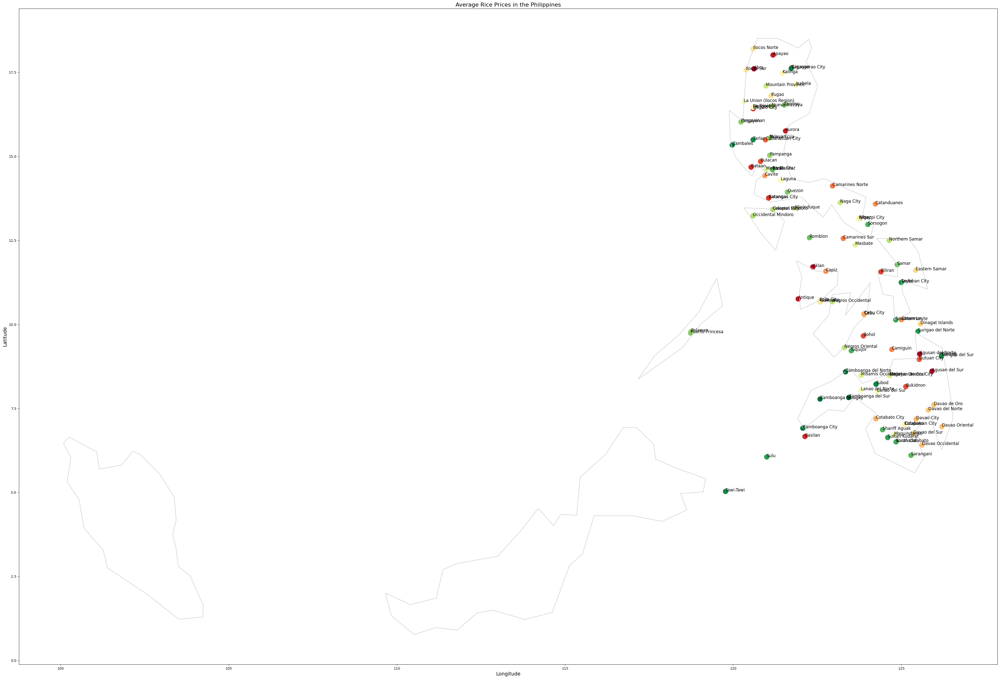

In [30]:
# Create a GeoDataFrame from ave_rice
gdf = gpd.GeoDataFrame(
    ave_rice,
    geometry=gpd.points_from_xy(ave_rice.longitude, ave_rice.latitude)
)

# Create a GeoDataFrame for the world map
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Set the bounding box to focus only on the Philippines
bbox = [117, 127, 5, 20]  # [minx, maxx, miny, maxy]
world = world.cx[bbox[0]:bbox[1], bbox[2]:bbox[3]]

# Plot the outline of the Philippines in light gray
world.boundary.plot(figsize=(50, 50), color='lightgray')

# Plot the points on the map with colors based on price
gdf.plot(ax=plt.gca(), c=ave_rice['price'], cmap='RdYlGn', markersize=200, legend=True)

# Add labels to the points with smaller fonts
for idx, row in ave_rice.iterrows():
    plt.text(row['longitude'], row['latitude'], row['market'], fontsize=12)

# Set plot parameters
plt.title('Average Rice Prices in the Philippines', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)

# Display the map
plt.show()

<ipython-input-40-14c9677c16b7>:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


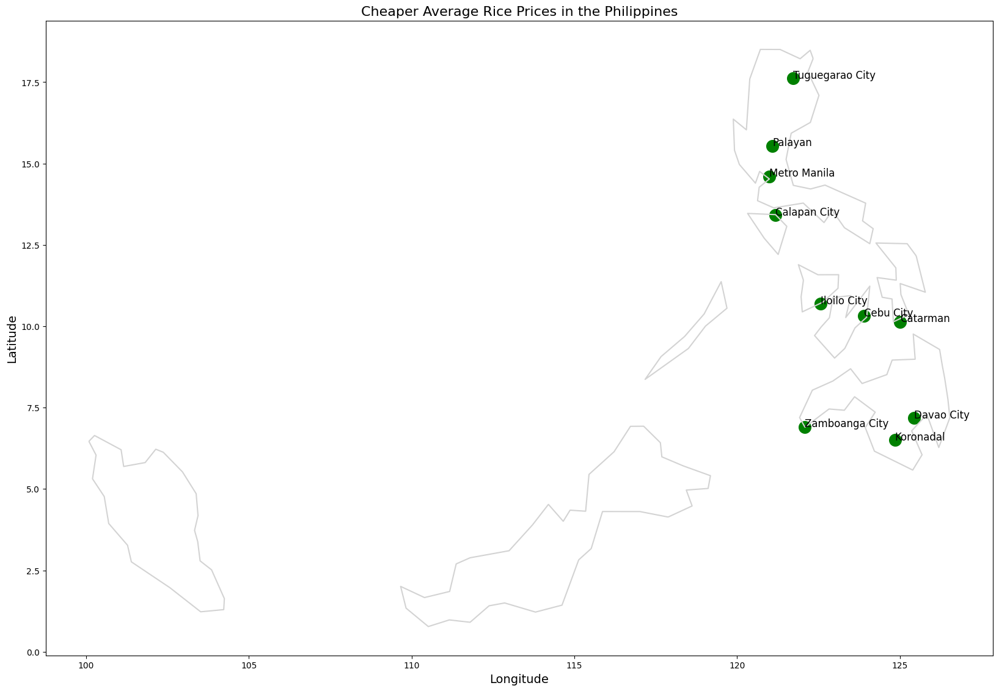

In [40]:
# Filter out markets with higher average prices
cheaper_markets = ave_rice[ave_rice['price'] <= 34.02]  # Replace YOUR_THRESHOLD with your desired threshold

# Create a GeoDataFrame for cheaper markets
gdf_cheaper = gpd.GeoDataFrame(
    cheaper_markets,
    geometry=gpd.points_from_xy(cheaper_markets.longitude, cheaper_markets.latitude)
)

# Create a GeoDataFrame for the world map
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Set the bounding box to focus only on the Philippines
bbox = [117, 127, 5, 20]  # [minx, maxx, miny, maxy]
world = world.cx[bbox[0]:bbox[1], bbox[2]:bbox[3]]

# Plot the outline of the Philippines in light gray
world.boundary.plot(figsize=(20, 20), color='lightgray')

# Plot the points on the map with only cheaper markets in green
gdf_cheaper.plot(ax=plt.gca(), color='green', markersize=200)

# Add labels to the points with smaller fonts
for idx, row in cheaper_markets.iterrows():
    plt.text(row['longitude'], row['latitude'], row['market'], fontsize=12)

# Set plot parameters
plt.title('Cheaper Average Rice Prices in the Philippines', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)

# Display the map
plt.show()

In [41]:
ave_coconut = df_coconut.groupby('market')['price'].mean().reset_index()
ave_coconut = pd.merge(ave_coconut, df_coconut[['market', 'latitude', 'longitude']].drop_duplicates(), on='market', how='left')
ave_coconut

,market,price,latitude,longitude
0,Abra,40.218750,17.600651,120.619362
1,Agusan del Norte,21.603750,9.116421,125.547306
2,Agusan del Sur,22.370500,8.605494,125.911126
3,Aklan,21.085750,11.706772,122.370090
4,Albay,24.371250,13.146926,123.750464
...,...,...,...,...
77,Zambales,31.655250,15.336727,119.974099
78,Zamboanga City,22.265714,6.910255,122.071715
79,Zamboanga Sibugay,18.595250,7.777226,122.584100
80,Zamboanga del Norte,23.985500,8.587207,123.340790


<ipython-input-44-3ac97d716679>:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


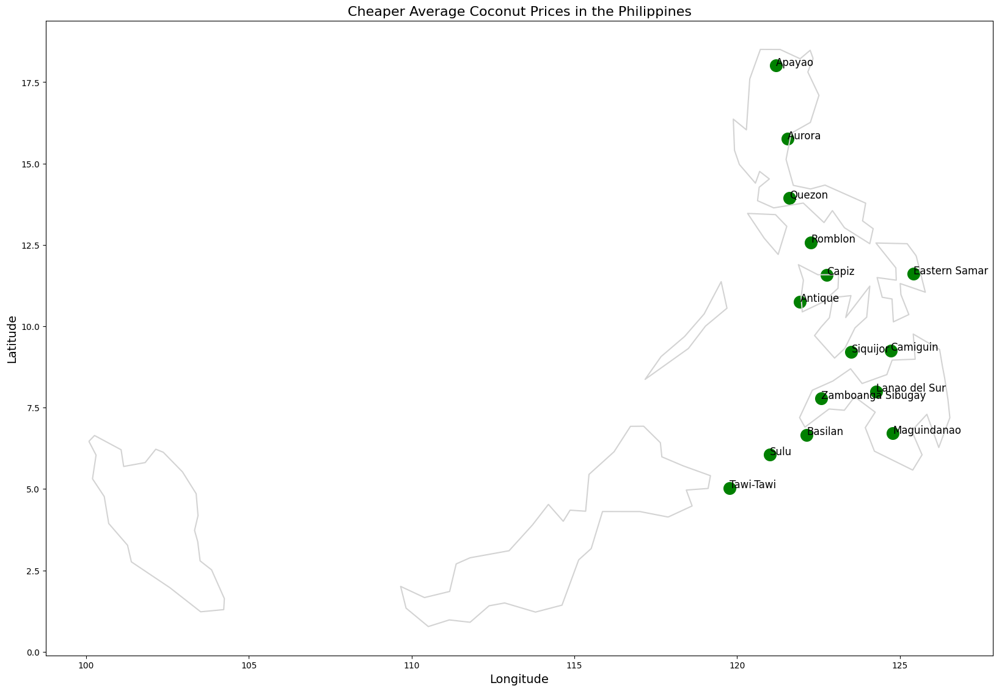

In [44]:
# Filter out markets with higher average prices
cheaper_markets_coconut = ave_coconut[ave_coconut['price'] <= 19]  # Replace YOUR_THRESHOLD with your desired threshold

# Create a GeoDataFrame for cheaper coconut markets
gdf_cheaper_coconut = gpd.GeoDataFrame(
    cheaper_markets_coconut,
    geometry=gpd.points_from_xy(cheaper_markets_coconut.longitude, cheaper_markets_coconut.latitude)
)

# Create a GeoDataFrame for the world map
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Set the bounding box to focus only on the Philippines
bbox = [117, 127, 5, 20]  # [minx, maxx, miny, maxy]
world = world.cx[bbox[0]:bbox[1], bbox[2]:bbox[3]]

# Plot the outline of the Philippines in light gray
world.boundary.plot(figsize=(20, 20), color='lightgray')

# Plot the points on the map with only cheaper coconut markets in green
gdf_cheaper_coconut.plot(ax=plt.gca(), color='green', markersize=200)

# Add labels to the points with smaller fonts
for idx, row in cheaper_markets_coconut.iterrows():
    plt.text(row['longitude'], row['latitude'], row['market'], fontsize=12)

# Set plot parameters
plt.title('Cheaper Average Coconut Prices in the Philippines', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)

# Display the map
plt.show()

In [45]:
ave_fish = df_fish.groupby('market')['price'].mean().reset_index()
ave_fish = pd.merge(ave_fish, df_fish[['market', 'latitude', 'longitude']].drop_duplicates(), on='market', how='left')
ave_fish

,market,price,latitude,longitude
0,Abra,195.52750,17.600651,120.619362
1,Agusan del Norte,184.15625,9.116421,125.547306
2,Agusan del Sur,192.49325,8.605494,125.911126
3,Aklan,168.64000,11.706772,122.370090
4,Albay,169.84950,13.146926,123.750464
...,...,...,...,...
90,Zambales,172.48075,15.336727,119.974099
91,Zamboanga City,167.11700,6.910255,122.071715
92,Zamboanga Sibugay,149.06175,7.777226,122.584100
93,Zamboanga del Norte,165.31200,8.587207,123.340790


<ipython-input-50-79650a03b829>:11: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


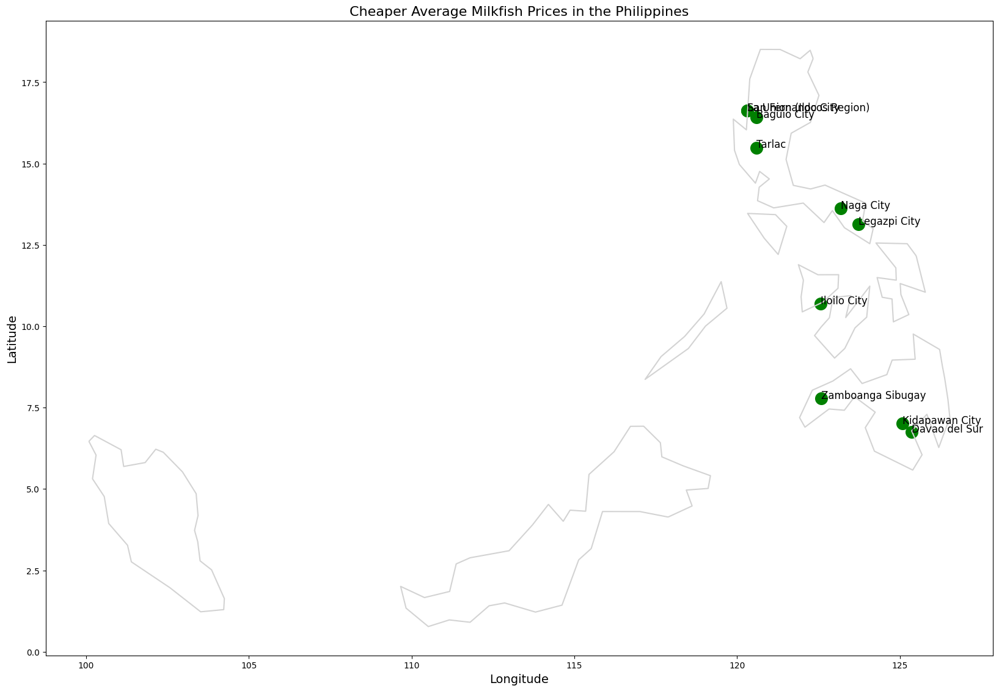

In [50]:
# Filter out markets with higher average prices
cheaper_markets_fish = ave_fish[ave_fish['price'] <= 162]  # Replace YOUR_THRESHOLD with your desired threshold

# Create a GeoDataFrame for cheaper fish markets
gdf_cheaper_fish = gpd.GeoDataFrame(
    cheaper_markets_fish,
    geometry=gpd.points_from_xy(cheaper_markets_fish.longitude, cheaper_markets_fish.latitude)
)

# Create a GeoDataFrame for the world map
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

# Set the bounding box to focus only on the Philippines
bbox = [117, 127, 5, 20]  # [minx, maxx, miny, maxy]
world = world.cx[bbox[0]:bbox[1], bbox[2]:bbox[3]]

# Plot the outline of the Philippines in light gray
world.boundary.plot(figsize=(20, 20), color='lightgray')

# Plot the points on the map with only cheaper fish markets in green
gdf_cheaper_fish.plot(ax=plt.gca(), color='green', markersize=200)

# Add labels to the points with smaller fonts
for idx, row in cheaper_markets_fish.iterrows():
    plt.text(row['longitude'], row['latitude'], row['market'], fontsize=12)

# Set plot parameters
plt.title('Cheaper Average Milkfish Prices in the Philippines', fontsize=16)
plt.xlabel('Longitude', fontsize=14)
plt.ylabel('Latitude', fontsize=14)

# Display the map
plt.show()


### Save as html

In [ ]:
!jupyter nbconvert --to html "/content/final_project_data cleaning_Mangrobang.ipynb"

[NbConvertApp] Converting notebook /content/final_project_data cleaning_Mangrobang.ipynb to html
[NbConvertApp] Writing 646605 bytes to /content/final_project_data cleaning_Mangrobang.html
